<a href="https://colab.research.google.com/github/BrendaLoznik/waterpumps/blob/main/waterpumps_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1 Housekeeping

### 1.1 Load libraries

In [1]:
pip install folium

In [2]:
#basic libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import folium

In [3]:
pd.set_option("display.max_columns", 100)
pd.set_option("display.max_rows", 200)

### 1.2 Custom functions

In [4]:
#custom function that creates a numerical data quality report
def numerical_dqr(df):
  
  #select numerical columns
  numerical = df.select_dtypes(include = ['int', 'Int64', 'float']).columns.tolist()
  
  #data type
  data_types = pd.DataFrame(
    df[numerical].dtypes,
    columns=['Data Type'])
  
  #missing data
  missing_data = pd.DataFrame(
    df[numerical].isnull().sum(),
    columns=['Missing Values'])
  
  #unique values
  unique_values = pd.DataFrame(
    columns=['Unique Values'])
  for row in list(df[numerical].columns.values):
    unique_values.loc[row] = [df[numerical][row].nunique()]
    
    #number of records
  count_values = pd.DataFrame(
    columns=['Records'])
  for row in list(df[numerical].columns.values):
      count_values.loc[row] = [df[numerical][row].count()]
    
    #minimum value
  maximum_values = pd.DataFrame(
    columns=['Maximum Value'])
  for row in list(df[numerical].columns.values):
      maximum_values.loc[row] = [df[numerical][row].max()]
    
  #maximum value
  minimum_values = pd.DataFrame(
    columns=['Minimum Value'])
  for row in list(df[numerical].columns.values):
      minimum_values.loc[row] = [df[numerical][row].min()]
    
  #mean value
  mean_values = pd.DataFrame(
    columns=['Mean Value'])
  for row in list(df[numerical].columns.values):
      mean_values.loc[row] = [df[numerical][row].mean()]
    
  #first quartile
  quartile_1 = pd.DataFrame(
    columns=['1st Quartile'])
  for row in list(df[numerical].columns.values):
      quartile_1.loc[row] = [df[numerical][row].quantile(0.25)]
    
  #median
  median = pd.DataFrame(
  columns=['Median'])
  for row in list(df[numerical].columns.values):
    median.loc[row] = [df[numerical][row].quantile(0.5)]
    
  #third quartile
  quartile_3 = pd.DataFrame(
    columns=['3rd Quartile'])
  for row in list(df[numerical].columns.values):
    quartile_3.loc[row] = [df[numerical][row].quantile(0.75)]
    
  #join columns 
  dq_report_num = data_types.join(count_values).join(missing_data).join(unique_values).join(minimum_values).join(maximum_values).join(mean_values).join(quartile_1).join(median).join(quartile_3)
  
  #percentage missing
  dq_report_num['Missing %'] = (dq_report_num['Missing Values'] / len(df[numerical]) *100)
  
  # change order of columns
  dq_report_num = dq_report_num[['Data Type', 'Records', 'Unique Values', 'Missing Values', 'Missing %', 'Mean Value', 'Minimum Value', '1st Quartile', 'Median', '3rd Quartile', 'Maximum Value', ]]

  #round
  dq_report_num[['Missing %', 'Mean Value', 'Minimum Value', '1st Quartile', 'Median', '3rd Quartile', 'Maximum Value']] =   dq_report_num[['Missing %', 'Mean Value', 'Minimum Value', '1st Quartile', 'Median', '3rd Quartile', 'Maximum Value']].round(1)
  
   
  #rreturn report
  return(dq_report_num)

In [5]:
def categorical_dqr(df):

  #select categorical columns
  categorical = df.select_dtypes(include = 'object').columns.tolist()

  #datatype
  data_types = pd.DataFrame(
    df[categorical].dtypes,
    columns=['Data Type'])
  
  #count
  count_values = pd.DataFrame(
      columns=['Records'])
  for row in list(raw[categorical].columns.values):
    count_values.loc[row] = [raw[categorical][row].count()]
  
   #missing data
  missing_data = pd.DataFrame(
    df[categorical].isnull().sum(),
    columns=['Missing Values'])
  
  #unique values
  unique_values = pd.DataFrame(
      columns=['Unique Values'])
  for row in list(raw[categorical].columns.values):
    unique_values.loc[row] = [raw[categorical][row].nunique()]

  #mode
  mode_values = pd.DataFrame(
      columns=['Mode'])
  for row in list(raw[categorical].columns.values): 
    mode_values.loc[row] = [raw[categorical][row].mode()[0]]
    mode = mode_values.loc[row]
  
  #mode frequency
  listModeFreq = []
  for row in categorical:
    mode = raw[row].mode().iat[0]
    ModeFreq = raw[row].value_counts()[mode]
    #print(x, mode, raw[x].value_counts()[mode])
    listModeFreq .append(ModeFreq )
  listModeFreq  = np.array(listModeFreq )
    
  
   #create data quality report
  dq_report_cat = data_types.join(missing_data).join(count_values).join(unique_values).join(mode_values)
  dq_report_cat['Mode freq.'] = listModeFreq 
  dq_report_cat['Mode %'] = (dq_report_cat['Mode freq.'] / dq_report_cat['Records']*100) .astype('float')
  dq_report_cat['Missing %'] = (dq_report_cat['Missing Values'] / len(raw[categorical]) *100)

  #change order of columns
  dq_report_cat = dq_report_cat[['Data Type', 'Records', 'Unique Values', 'Missing Values', 'Missing %', 'Mode', 'Mode freq.', 'Mode %']]
  dq_report_cat[['Missing %', 'Mode %']] =   dq_report_cat[['Missing %'	,  'Mode %']].round(1  )

  #return report
  return(dq_report_cat)

In [6]:
#custom function that creates a numerical data quality report
def datetime_dqr(df):
  
  #select numerical columns
  date = df.select_dtypes(include = ['datetime64[ns]']).columns.tolist()
  
  #data type
  data_types = pd.DataFrame(
    df[date].dtypes,
    columns=['Data Type'])
  
  #missing data
  missing_data = pd.DataFrame(
    df[date].isnull().sum(),
    columns=['Missing Values'])
  
  #unique values
  unique_values = pd.DataFrame(
    columns=['Unique Values'])
  for row in list(df[date].columns.values):
    unique_values.loc[row] = [df[date][row].nunique()]
    
    #number of records
  count_values = pd.DataFrame(
    columns=['Records'])
  for row in list(df[date].columns.values):
      count_values.loc[row] = [df[date][row].count()]
    
    #minimum value
  maximum_values = pd.DataFrame(
    columns=['Maximum Value'])
  for row in list(df[date].columns.values):
      maximum_values.loc[row] = [df[date][row].max()]
    
  #maximum value
  minimum_values = pd.DataFrame(
    columns=['Minimum Value'])
  for row in list(df[date].columns.values):
      minimum_values.loc[row] = [df[date][row].min()]
    
  #mean value
  mean_values = pd.DataFrame(
    columns=['Mean Value'])
  for row in list(df[date].columns.values):
      mean_values.loc[row] = [df[date][row].mean()]
    
  #first quartile
  quartile_1 = pd.DataFrame(
    columns=['1st Quartile'])
  for row in list(df[date].columns.values):
      quartile_1.loc[row] = [df[date][row].quantile(0.25)]
    
  #median
  median = pd.DataFrame(
  columns=['Median'])
  for row in list(df[date].columns.values):
    median.loc[row] = [df[date][row].quantile(0.5)]
    
  #third quartile
  quartile_3 = pd.DataFrame(
    columns=['3rd Quartile'])
  for row in list(df[date].columns.values):
    quartile_3.loc[row] = [df[date][row].quantile(0.75)]
    
  #join columns 
  dq_report_date = data_types.join(count_values).join(missing_data).join(unique_values).join(minimum_values).join(maximum_values).join(mean_values).join(quartile_1).join(median).join(quartile_3)
  
  #percentage missing
  dq_report_date['Missing %'] = (dq_report_date['Missing Values'] / len(df[date]) *100)
  
  # change order of columns
  dq_report_date = dq_report_date[['Data Type', 'Records', 'Unique Values', 'Missing Values', 'Missing %', 'Mean Value', 'Minimum Value', '1st Quartile', 'Median', '3rd Quartile', 'Maximum Value', ]]
   
  #round   
  dq_report_date['Mean Value'] = dq_report_date['Mean Value'].dt.date
  dq_report_date['Missing %'] = dq_report_date['Missing %'].round(1)

    
  #rreturn report
  return(dq_report_date)

In [7]:
#custome duplicate checker
def duplicate_checker(df):
  duplicates = df.duplicated(keep = 'first').sum()
  print("Number of duplicates: {}".format(duplicates))
  print("Total number of records: {}".format(len(df)))
  print("Percentage duplicated: {}".format((duplicates/len(df))*100))

In [8]:
def kdeplotter (dataset, feature, rows, columns):
  fig, axes = plt.subplots(nrows=rows,ncols=columns, figsize = (30,12))
  plot = 0
  for i in range(rows):
    for j in range(columns):
       ax = sns.kdeplot(data = dataset, x =feature[plot] , ax = axes[i][j],    shade = True, color  = "black" )
       plot +=1

In [9]:
def countplotter (dataset, feature, rows, columns):
    fig, axes = plt.subplots(nrows=rows,ncols=columns, figsize = (30,50))
    plot = 0
    for i in range(rows):
        for j in range(columns):
             ax = sns.countplot(data = dataset, x =feature[plot] , ax = axes[i][j], palette='Set2' )
             ax.set_title(feature[plot])
             ax.set_xlabel("")
             ax.set_xticklabels(ax.get_xticklabels(), rotation = 70, fontsize=9)
             plot +=1

In [43]:
def distribution_checker (data, xlabel):
  grouped = data.groupby([xlabel, 'status_group'])['id'].count().reset_index()
  pivot = grouped.pivot_table(index = xlabel, columns = 'status_group', fill_value = 0)
  mi=pivot.columns
  mi.tolist()
  ind = pd.Index([ str(e[1])  for e in mi.tolist()])
  pivot.columns = ind
  pivot['nr_pumps'] = pivot['functional'] +pivot['functional needs repair'] +pivot['non functional']
  pivot['all_pumps'] = pivot['nr_pumps'].sum()
  pivot['perc_total_pumps'] =((pivot['nr_pumps']/pivot['all_pumps'])*100).round(1)
  pivot['perc_functional'] = ((pivot['functional']/pivot['nr_pumps'])*100).round(1)
  pivot['perc_non_functional'] = ((pivot['non functional']/pivot['nr_pumps'])*100).round(1)
  pivot['perc_functional_needs_repair'] = ((pivot['functional needs repair']/pivot['nr_pumps'])*100).round(1)
  pivot = pivot.drop(['functional', 'functional needs repair', 'non functional', 'all_pumps'], axis=1)
  return(pivot)

### 1.3 Load data

In [11]:
from google.colab import drive 
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [12]:
#import data
train_labels = pd.read_csv('/content/gdrive/MyDrive/Kaggle/Waterpump-github/train_labels.csv')
train_values = pd.read_csv('/content/gdrive/MyDrive/Kaggle/Waterpump-github/train_values.csv', parse_dates = ['date_recorded' ])
test_values = pd.read_csv('/content/gdrive/MyDrive/Kaggle/Waterpump-github/test_values.csv', parse_dates = ['date_recorded' ])

#merge train values and train labels to single dataset
train= pd.merge(train_labels , train_values, on='id')


In [13]:
#concatenate train and test for data visualization
raw = pd.concat([train, test_values])
raw.head()

,id,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,functional,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,functional,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,functional,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,non functional,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,functional,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe


# 2 EDA - overview

### 2.1 Duplicates

In [14]:
#Good news! There are no duplicate recoreds in the dataset.
duplicate_checker(raw)

Number of duplicates: 0
Total number of records: 74250
Percentage duplicated: 0.0


### 2.2 Numerical data

In [15]:
#plot a numerical data quality report
numerical_dqr = numerical_dqr(raw)
numerical_dqr

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
id,int64,74250,74250,0,0.0,37124.5,0,18562.2,37124.5,55686.8,74249
amount_tsh,float64,74250,102,0,0.0,318.7,0,0.0,0.0,20.0,350000
gps_height,int64,74250,2456,0,0.0,665.7,-90,0.0,364.0,1317.0,2777
longitude,float64,74250,71870,0,0.0,34.1,0,33.1,34.9,37.2,40.3452
latitude,float64,74250,71869,0,0.0,-5.7,-11.6494,-8.5,-5.0,-3.3,-2e-08
num_private,int64,74250,68,0,0.0,0.5,0,0.0,0.0,0.0,1776
region_code,int64,74250,27,0,0.0,15.3,1,5.0,12.0,17.0,99
district_code,int64,74250,20,0,0.0,5.6,0,2.0,3.0,5.0,80
population,int64,74250,1128,0,0.0,180.8,0,0.0,25.0,215.0,30500
construction_year,int64,74250,55,0,0.0,1298.5,0,0.0,1986.0,2004.0,2013


A data quality report provides a great overview of the dataset. It imediately shows us some things we should look out for:
* There are no missing values, but a longitude of zero does not exists in Tanzania. This makes me wonder if missing values are expressed as zero's.
* Some features like *region_code* and *district_code* might actually be categorical features.
* *Amount_tsh* and *num_private* appear to contain a lot of zero's.
* *Population* and *gps_height* appear to contain some outliers.

In [16]:
#convert faulty datatypes
raw[['region_code','district_code', 'num_private', 'id']] = raw[['region_code','district_code', 'num_private', 'id']].astype('object')

### 2.3 Categorical data

In [17]:
categorical_dqr = categorical_dqr(raw)
categorical_dqr 

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
id,object,74250,74250,0,0.0,0,1,0.0
status_group,object,59400,3,14850,20.0,functional,32259,54.3
funder,object,69746,2140,4504,6.1,Government Of Tanzania,11299,16.2
installer,object,69718,2410,4532,6.1,DWE,21751,31.2
wpt_name,object,74250,45684,0,0.0,none,4440,6.0
num_private,object,74250,68,0,0.0,0,73299,98.7
basin,object,74250,9,0,0.0,Lake Victoria,12871,17.3
subvillage,object,73780,21425,470,0.6,Shuleni,646,0.9
region,object,74250,21,0,0.0,Iringa,6599,8.9
region_code,object,74250,27,0,0.0,11,6608,8.9


The categorical data quality report again provides us with some important insights
* *installer*, *funder*, *wpt_name*, *subvillage* and a few other features have very high cardinality. *num_private* also contains very little variation.
* *recorded_by* consists of a single value and therefore contains no information
* Several features have missing values


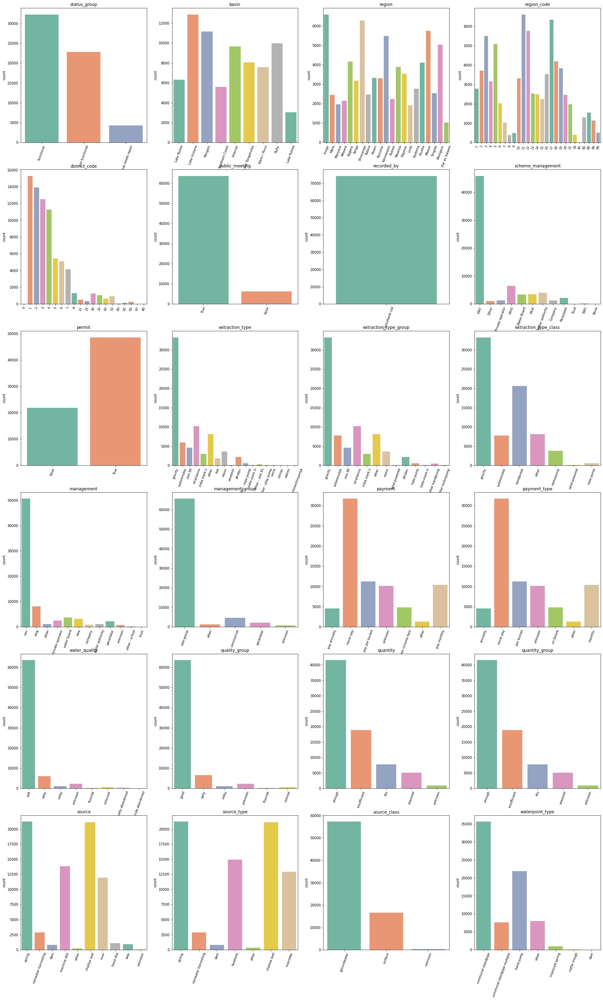

In [20]:
#create a list of categorical features with low cardinality
low_cardinal = categorical_dqr [categorical_dqr ['Unique Values'] <=50]
cardinal_index = low_cardinal.index
low_cardinal_list = cardinal_index.to_list()

#create countplots
try:
    countplotter (raw, raw[low_cardinal_list].columns, 6,4)
except IndexError: 
    pass 

# 3 EDA - features

#### **Amount tsh**

In [21]:
numerical_dqr.loc[['amount_tsh']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
amount_tsh,float64,74250,102,0,0.0,318.7,0,0.0,0.0,20.0,350000


In [22]:
#amount_tsh has 102 unique values, but 70% of them consist of zero's. These could very well be missing values.
tsh = raw['amount_tsh'].value_counts(normalize=True)
tsh.head(3)

0.0      0.700997
500.0    0.052175
50.0     0.041791
Name: amount_tsh, dtype: float64

In [23]:
#perhabs there is value hidden in the 'missigness' of amount_tsh, let's check this.
temp = train.copy()
temp['amount_tsh_missing'] = np.where( temp['amount_tsh']==0.0, 1, 0) # if amount_tsh =0, then 1, otherwise 0

#visualize the distribution of the y-variable 'status_group' 
distribution_checker(temp, 'amount_tsh_missing')

,,total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
0,0,17761,70.7,22.2,7.1
1,1,41639,47.3,45.4,7.3


Assuming that missing values are encoded as zero, we can see that there is some information hidden in a feature that captures its missingness. Pumps where *amount_tsh* is unavailable are less often functional and more often non-functional.

### **Date recorded**

In [24]:
datetime_dqr(raw)

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
date_recorded,datetime64[ns],74250,369,0,0.0,2012-03-28,2001-03-26,2011-04-01,2012-10-10,2013-02-09,2013-12-03


The status of the pumps was recorded between 2001 and 2013. Nothing stands out to me when looking at the data quality report. This feature could be usefull when calculating the age of the well at the time of recording.

**Recorded year**

In [46]:
#create 'recorded_year' feature
temp = train.copy()
temp['recorded_year'] = pd.DatetimeIndex(temp ['date_recorded']).year

#check the distribution of 'status_group' for the 'recorded_year' feature
recorded = distribution_checker(temp ,'recorded_year')
recorded

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
recorded_year,,,,,
2002,1,0.0,100.0,0.0,0.0
2004,30,0.1,33.3,63.3,3.3
2011,28674,48.3,56.6,37.1,6.3
2012,6424,10.8,48.7,45.7,5.6
2013,24271,40.9,53.2,38.0,8.8


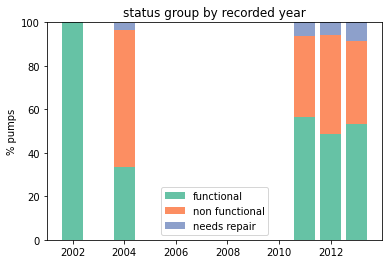

In [26]:
#plot status group by recorded year
fig, ax = plt.subplots()
labels = temp['recorded_year'].sort_values().unique()
ax.bar(labels, recorded['perc_functional'], label = 'functional' ,  color = '#66c2a5')
ax.bar (labels, recorded['perc_non_functional'], label = 'non functional', bottom = recorded['perc_functional'] , color = '#fc8e62')
ax.bar(labels, recorded['perc_functional_needs_repair'], label = 'needs repair', bottom = recorded['perc_functional'] + recorded['perc_non_functional'], color = '#8da0cb')
ax.set_title('status group by recorded year')
ax.set_ylabel('% pumps')
plt.legend()
plt.show()

The fast majority of the recordings date from 2011 and 2013. There appears to be no effect of year of recording on the status of the pumps.

**Recorded month**

In [47]:
#create 'recorded_year' feature
temp = train.copy()
temp['recorded_month'] = pd.DatetimeIndex(temp ['date_recorded']).month

#check the distribution of 'status_group' for the 'recorded_month' feature
recorded = distribution_checker(temp ,'recorded_month')
recorded

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
recorded_month,,,,,
1,6354,10.7,41.1,46.2,12.7
2,12402,20.9,55.2,37.3,7.5
3,17936,30.2,61.7,33.3,5.0
4,3970,6.7,51.6,37.3,11.0
5,336,0.6,60.1,36.9,3.0
6,346,0.6,78.0,19.4,2.6
7,6928,11.7,50.2,41.9,7.9
8,3364,5.7,51.1,41.4,7.5
9,328,0.6,65.2,31.7,3.0


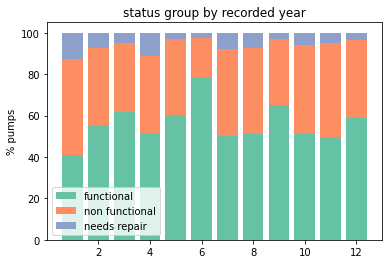

In [28]:
#plot status group by 'recorded_month'
fig, ax = plt.subplots()
labels = temp['recorded_month'].sort_values().unique()
ax.bar(labels, recorded['perc_functional'], label = 'functional' ,  color = '#66c2a5')
ax.bar (labels, recorded['perc_non_functional'], label = 'non functional', bottom = recorded['perc_functional'] , color = '#fc8e62')
ax.bar(labels, recorded['perc_functional_needs_repair'], label = 'needs repair', bottom = recorded['perc_functional'] + recorded['perc_non_functional'], color = '#8da0cb')
ax.set_title('status group by recorded year')
ax.set_ylabel('% pumps')
plt.legend()
plt.show()

The status of most pumps is recorded in February and March and far less often in May and June. This is interessting because January and February are part of the short dry season whilst  the long rainy season lasts from March to late May. It might be easier to check the status of pumps whilst the weather is good. 

There appears to be a difference in the percentage of functional pumps over the different months, but this effect might be biased by a lower number of records during these months. 

### **Funder**

In [29]:
categorical_dqr.loc[['funder']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
funder,object,69746,2140,4504,6.1,Government Of Tanzania,11299,16.2


In [44]:
#check the distribution of status groups for the 10 most frequent funders
funder = distribution_checker(raw, 'funder')
funder = funder.sort_values('nr_pumps', ascending= False)
funder.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
funder,,,,,
Government Of Tanzania,9084,16.3,41.0,51.3,7.7
Danida,3114,5.6,55.0,39.9,5.1
Hesawa,2202,3.9,42.5,47.0,10.5
Rwssp,1374,2.5,58.6,33.5,7.9
World Bank,1349,2.4,40.4,52.4,7.2
Kkkt,1287,2.3,56.2,38.7,5.1
World Vision,1246,2.2,59.6,29.9,10.5
Unicef,1057,1.9,56.8,33.9,9.4
Tasaf,877,1.6,56.2,36.5,7.3


Funder has over 2000 unique categories. The Government of Tanzania is with 16% the most common funder.  Just by looking at the top 10 most common funders we can see the 'status_group' distribution differs. I therefore think 'funder' could be an interessting column to include in a model, but we have to find a suitable way to encode it without increasing the dimensionality of the dataframe too much. 

### **Installer**

In [41]:
categorical_dqr.loc[['installer']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
installer,object,69718,2410,4532,6.1,DWE,21751,31.2


In [45]:
#check the distribution of status groups for the 10 most frequent installer
installer = distribution_checker(raw, 'installer')
installer = installer.sort_values('nr_pumps', ascending= False)
installer.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
installer,,,,,
DWE,17402,31.2,54.2,36.5,9.3
Government,1825,3.3,29.3,56.7,14.0
RWE,1206,2.2,25.2,63.4,11.4
Commu,1060,1.9,68.3,28.7,3.0
DANIDA,1050,1.9,51.6,40.5,7.9
KKKT,898,1.6,47.0,46.1,6.9
Hesawa,840,1.5,56.5,41.4,2.0
0,777,1.4,57.3,42.3,0.4
TCRS,707,1.3,41.0,53.0,5.9


Installer has like funder a very high cardinality. DWE is by far the most common installer. Again we see differences in the distribution of 'status_group' in the top 10 installers. Installer could be an interessting feature, but it has to be encoded properly to avoid increasing the dimensionality of the dataset.

### **GPS height**

In [48]:
numerical_dqr.loc[['gps_height']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
gps_height,int64,74250,2456,0,0.0,665.7,-90,0.0,364.0,1317.0,2777


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


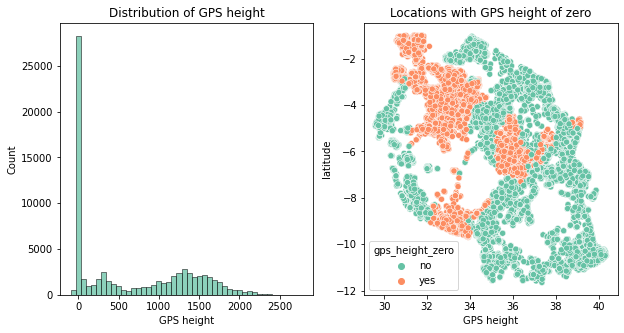

In [74]:
fig, axes = plt.subplots(1, 2,  figsize=(10,5))

#plot distribution of gps height
sns.histplot( raw[ 'gps_height'], color = '#66c2a5', ax=axes[0])
axes[0].set(title = 'Distribution of GPS height', xlabel = 'GPS height')

#plot locations where gps height is zero
temp = raw[raw['longitude']!=0]  #only include records where logitude isn't zero
temp['gps_height_zero'] = np.where(temp['gps_height']==0, 'yes', 'no')
sns.scatterplot(x= temp['longitude'], y = temp['latitude'], hue = temp['gps_height_zero'], palette='Set2', ax = axes[1])
axes[1].set(title = 'Locations with GPS height of zero', xlabel = 'GPS height')

plt.show()

Tanzania is not located below sealevel, so any negative value for gps height cannot be correct. The normal error is gps altitude is is +- 15 meter and this applies 95% of the time. The other 5% of the time you can have any value. However, here we don't know if the gps height indicates the height of the water level, or the location of the wel....  What is clear is that the majority of the locations where a gps height of zero is registered are not located at places that are located at sealevel. I therefore conclude that missing values are registered as zero.

### **Longitude**

In [87]:
numerical_dqr.loc[['longitude']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
longitude,float64,74250,71870,0,0.0,34.1,0,33.1,34.9,37.2,40.3452


A longitude of zero does not exist for Tanzania. Missing values are imputed as zero.

### **Latitude**

In [88]:
numerical_dqr.loc[['latitude']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
latitude,float64,74250,71869,0,0.0,-5.7,-11.6494,-8.5,-5.0,-3.3,-2e-08


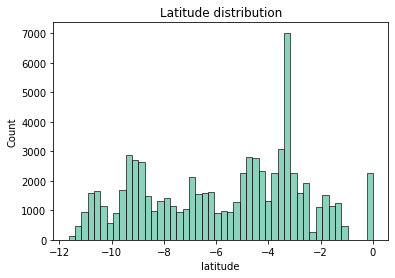

In [92]:
#distribution of latitude
ax = sns.histplot( raw[ 'latitude'], color = '#66c2a5')
ax.set(title = 'Latitude distribution')
plt.show()

From the data quality report the presense of zero is not immediately clear, but after plotting we can see that latitudes with a value of zero are indeed present. These represent missing values and need to be imputed properly.

### **Wpt Name**

In [75]:
categorical_dqr.loc[['wpt_name']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
wpt_name,object,74250,45684,0,0.0,none,4440,6.0


In [76]:
#check the distribution of status groups for the 10 most frequent namesb
name = distribution_checker(raw, 'wpt_name')
name= name.sort_values('nr_pumps', ascending= False)
name.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
wpt_name,,,,,
none,3563,6.0,73.8,24.1,2.1
Shuleni,1748,2.9,49.1,42.7,8.2
Zahanati,830,1.4,51.8,38.8,9.4
Msikitini,535,0.9,49.2,42.6,8.2
Kanisani,323,0.5,48.0,45.5,6.5
Bombani,271,0.5,58.3,33.9,7.7
Sokoni,260,0.4,46.2,43.8,10.0
Ofisini,254,0.4,43.3,52.4,4.3
School,208,0.4,41.8,51.9,6.2


Waterpoint name has an extremely high cardinality. The most common name is 'None', indicating that the pump has no name. As expected, the name of the waterpump appears to have no relationship with the status of the pump. This is a feature that we can drop later.

### **Num private**

In [77]:
categorical_dqr.loc[['num_private']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
num_private,object,74250,68,0,0.0,0,73299,98.7


It is immediately clear that this feature will hold little information as 98.7% of the records consists of the value zero. This is a good candidate to drop from later analysis.

### **Basin**

In [78]:
categorical_dqr.loc[['basin']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
basin,object,74250,9,0,0.0,Lake Victoria,12871,17.3


,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
basin,,,,,
Lake Victoria,10248,17.3,49.8,40.6,9.7
Pangani,8940,15.1,60.1,34.6,5.3
Rufiji,7976,13.4,63.5,31.0,5.5
Internal,7785,13.1,57.6,35.3,7.2
Lake Tanganyika,6432,10.8,48.3,40.2,11.5
Wami / Ruvu,5987,10.1,52.4,43.1,4.5
Lake Nyasa,5085,8.6,65.4,29.7,4.9
Ruvuma / Southern Coast,4493,7.6,37.2,55.6,7.3
Lake Rukwa,2454,4.1,40.7,48.2,11.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


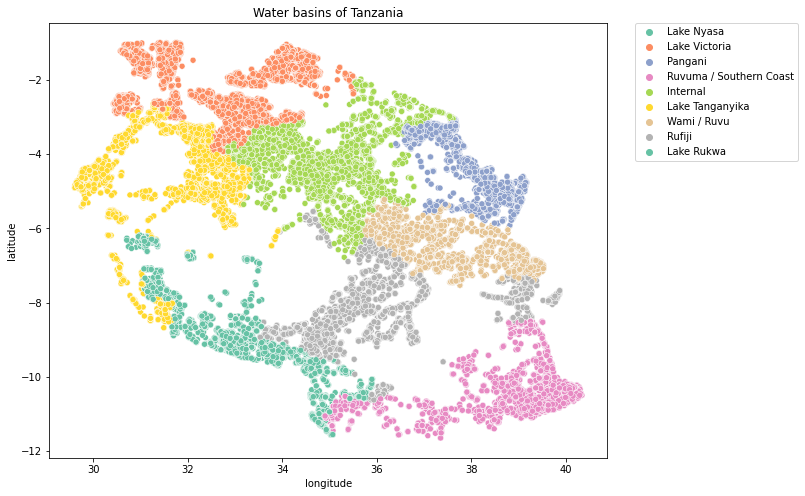

In [85]:
#plot the water basins of Tanzania
fig, axes = plt.subplots(  figsize=(10,8))
temp = raw[raw['longitude']!=0]  #only include records where logitude isn't zero
temp['gps_height_zero'] = np.where(temp['gps_height']==0, 'yes', 'no')
ax = sns.scatterplot(x= temp['longitude'], y = temp['latitude'], hue = temp['basin'], palette='Set2')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
ax.set(title = 'Water basins of Tanzania')
plt.show()

In [86]:
basin = distribution_checker(raw, 'basin')
basin = basin.sort_values('nr_pumps', ascending= False)
basin.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
basin,,,,,
Lake Victoria,10248,17.3,49.8,40.6,9.7
Pangani,8940,15.1,60.1,34.6,5.3
Rufiji,7976,13.4,63.5,31.0,5.5
Internal,7785,13.1,57.6,35.3,7.2
Lake Tanganyika,6432,10.8,48.3,40.2,11.5
Wami / Ruvu,5987,10.1,52.4,43.1,4.5
Lake Nyasa,5085,8.6,65.4,29.7,4.9
Ruvuma / Southern Coast,4493,7.6,37.2,55.6,7.3
Lake Rukwa,2454,4.1,40.7,48.2,11.0


The distribution of pumps over the different basins if fairly equal. We previously saw that certain regions have much more functional or non-functional pumps. It is therefore not surprising that certain basins also have more or less functional pumps. 

### **Region**

In [98]:
categorical_dqr.loc[['region']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
region,object,74250,21,0,0.0,Iringa,6599,8.9


In [104]:
region = distribution_checker(raw, 'region')
region = region.sort_values('nr_pumps', ascending= False)
region.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
region,,,,,
Iringa,5294,8.9,78.2,19.5,2.3
Shinyanga,4982,8.4,56.0,31.3,12.7
Mbeya,4639,7.8,50.0,39.1,10.9
Kilimanjaro,4379,7.4,60.3,32.4,7.4
Morogoro,4006,6.7,52.9,39.6,7.5
Arusha,3350,5.6,68.5,26.3,5.2
Kagera,3316,5.6,52.1,38.8,9.2
Mwanza,3102,5.2,48.4,45.7,5.9
Kigoma,2816,4.7,48.4,30.2,21.4


Tanzania has 21 different regions and from the table above we can already see that certain regions have a much higher proportion of functional pumps than other regions. The location of the pumps is therefore relevant. We can visulize this further using the library Folium.

In [113]:
#plot the percentage of functional pumps by region
m = folium.Map(location=[temp['latitude'].mean(), temp['longitude'].mean()], zoom_start=6)
state_geo = f"https://raw.githubusercontent.com/thadk/GeoTZ/499a496581977655d3ff50ff10e1676f4d69fdb9/TZA_adm1_mkoaTZ.geojson"

folium.Choropleth(
    geo_data=state_geo,
    data=region,
    columns=[region.index,"perc_functional"],
    key_on="properties.NAME_1",
    fill_color="Purples",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Functional pumps (%)",
    reset=True,
).add_to(m)

m

In [114]:
#plot the percentage of non-functional pumps by region
m = folium.Map(location=[temp['latitude'].mean(), temp['longitude'].mean()], zoom_start=6)
state_geo = f"https://raw.githubusercontent.com/thadk/GeoTZ/499a496581977655d3ff50ff10e1676f4d69fdb9/TZA_adm1_mkoaTZ.geojson"

folium.Choropleth(
    geo_data=state_geo,
    data=region,
    columns=[region.index,"perc_non_functional"],
    key_on="properties.NAME_1",
    fill_color="Purples",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Functional pumps (%)",
    reset=True,
).add_to(m)

m

In [115]:
#plot the percentage of functional-needs-repair pumps by region
m = folium.Map(location=[temp['latitude'].mean(), temp['longitude'].mean()], zoom_start=6)
state_geo = f"https://raw.githubusercontent.com/thadk/GeoTZ/499a496581977655d3ff50ff10e1676f4d69fdb9/TZA_adm1_mkoaTZ.geojson"

folium.Choropleth(
    geo_data=state_geo,
    data=region,
    columns=[region.index,"perc_functional_needs_repair"],
    key_on="properties.NAME_1",
    fill_color="Purples",
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name="Functional pumps (%)",
    reset=True,
).add_to(m)

m

### **Region code**

In [130]:
categorical_dqr.loc[['region_code']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
region_code,object,74250,27,0,0.0,11,6608,8.9


In [140]:
#group region_codes by region
region_code = raw.groupby([  'region', 'region_code',])['id'].count().reset_index()
region_code.head(10)

,region,region_code,id
0,Arusha,2,3709
1,Arusha,24,402
2,Dar es Salaam,7,1020
3,Dodoma,1,2779
4,Iringa,11,6599
5,Kagera,18,4174
6,Kigoma,16,3533
7,Kilimanjaro,3,5494
8,Lindi,8,375
9,Lindi,18,9


In [139]:
#check distribution of status group by region code
region_code = distribution_checker(raw, 'region_code')
region_code = region_code.sort_values('nr_pumps', ascending= False)
region_code.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
region_code,,,,,
11,5300,8.9,78.2,19.5,2.3
17,5011,8.4,56.0,31.3,12.7
12,4639,7.8,50.0,39.1,10.9
3,4379,7.4,60.3,32.4,7.4
5,4040,6.8,53.1,39.4,7.4
18,3324,5.6,52.0,38.8,9.1
19,3047,5.1,48.2,46.0,5.8
2,3024,5.1,65.4,28.8,5.8
16,2816,4.7,48.4,30.2,21.4


Tanzania has 21 different regions, but 27 different region_codes. This means that the regio_code feature contains slightly more information that the region feature. It must be said that some of the region_code categories contain only a few pumps. The region Arusha has 68.5% functional pumps. When we look at the region_codes within Arusha, we see that this percentage varies between 65 and 97%. This is a big and interessting difference!

### **District code**

In [141]:
categorical_dqr.loc[['district_code']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
district_code,object,74250,20,0,0.0,1,15299,20.6


In [142]:
#group region_codes by region
district_code = raw.groupby([  'region', 'district_code',])['id'].count().reset_index()
district_code.head(10)

,region,district_code,id
0,Arusha,1,226
1,Arusha,2,1460
2,Arusha,3,143
3,Arusha,5,245
4,Arusha,6,391
5,Arusha,7,1244
6,Arusha,30,402
7,Dar es Salaam,1,121
8,Dar es Salaam,2,633
9,Dar es Salaam,3,266


Tanzania has 20 different district numbers, but it appears that these districts are relevant in the region context. So both Arusha and Dar es Salaam have a district 1. It might be interesting to create a region-district feature to capture this information.

### **Lga**

In [143]:
categorical_dqr.loc[['lga']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
lga,object,74250,125,0,0.0,Njombe,3128,4.2


In [144]:
#group lga by region
lga = raw.groupby([  'region', 'lga',])['id'].count().reset_index()
lga.head(10)

,region,lga,id
0,Arusha,Arusha Rural,1521
1,Arusha,Arusha Urban,82
2,Arusha,Karatu,402
3,Arusha,Longido,391
4,Arusha,Meru,1244
5,Arusha,Monduli,226
6,Arusha,Ngorongoro,245
7,Dar es Salaam,Ilala,633
8,Dar es Salaam,Kinondoni,121
9,Dar es Salaam,Temeke,266


A region consists of different lga's. There are 125 different lga's, which is a bit too much to encode in a model, but it could be an useful feature for imputing missing geospatial data.

### **Ward**

In [145]:
categorical_dqr.loc[['ward']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
ward,object,74250,2098,0,0.0,Igosi,386,0.5


In [147]:
#group ward by lga
ward = raw.groupby([  'lga', 'ward'])['id'].count().reset_index()
ward.head(10)

,lga,ward,id
0,Arusha Rural,Bangata,43
1,Arusha Rural,Bwawani,46
2,Arusha Rural,Ilkiding'a,104
3,Arusha Rural,Kimnyaki,93
4,Arusha Rural,Kiranyi,139
5,Arusha Rural,Kisongo,37
6,Arusha Rural,Mateves,28
7,Arusha Rural,Mlangarini,111
8,Arusha Rural,Moivo,52
9,Arusha Rural,Moshono,57


A lga can be further divided into different wards. A total of 2098 wards can be found in the dataset. Because of the high cardinality we cannot use this feature in a model, but it is useful for imputing purposes.

### **Subvillage**

In [126]:
categorical_dqr.loc[['subvillage']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
subvillage,object,73780,21425,470,0.6,Shuleni,646,0.9


In [148]:
#group ward by lga
village= raw.groupby([  'lga', 'ward', 'subvillage'])['id'].count().reset_index()
village.head(10)

,lga,ward,subvillage,id
0,Arusha Rural,Bangata,Engikaleti,23
1,Arusha Rural,Bangata,Gwasei,2
2,Arusha Rural,Bangata,Kwaniche,5
3,Arusha Rural,Bangata,Lobolosi,1
4,Arusha Rural,Bangata,Melenyi,1
5,Arusha Rural,Bangata,Ndukenyi,2
6,Arusha Rural,Bangata,Ngwasei,3
7,Arusha Rural,Bangata,Sanganani,5
8,Arusha Rural,Bangata,Sangananu,1
9,Arusha Rural,Bwawani,Buluga,2


Wards can be further divided into subvillages. The dataset contains over 20.000 subvillage. Most subvillages contain only 1 or a few pumps. This feature can be useful for imputing missing geospatial data.


### **Population**

In [150]:
numerical_dqr.loc[['population']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
population,int64,74250,1128,0,0.0,180.8,0,0.0,25.0,215.0,30500


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


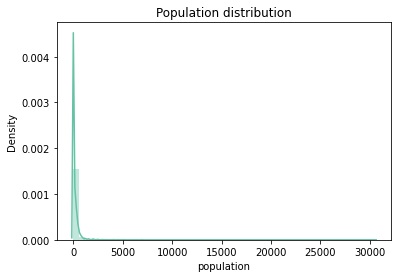

In [155]:
#distribution of population
ax = sns.distplot( raw[ 'population'], color = '#66c2a5')
ax.set(title = 'Population distribution')
plt.show()

Many towns appear to have zero inhabitants. Again, a clear sign that missing values are imputed as zero. The marjority of villages have around 100 inhabitants, but there are a few villages that have a much bigger population. Because of the high level of categorical features I expect a tree-based model will be most suitable for this dataset. I will therefore not worry about scaling or normalizing for now. It is possible to create population bins.

### **Permit**

In [158]:
categorical_dqr.loc[['permit']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mode,Mode freq.,Mode %
permit,object,70457,2,3793,5.1,True,48606,69.0


In [160]:
permit = distribution_checker(raw, 'permit')
permit.head(10)

,nr_pumps,perc_total_pumps,perc_functional,perc_non_functional,perc_functional_needs_repair
permit,,,,,
False,17492,31.0,51.7,40.7,7.5
True,38852,69.0,55.4,37.6,6.9


The fast majority of pumps is build with a permit. The percentage of functional or non-functional pumps doesn't differ much between pumps that have a permit in comparrisson with pumps that do not have a permit. I expect that this feature will not be important when predicting the status of a pump.

### **Construction year**

In [161]:
numerical_dqr.loc[['construction_year']]

,Data Type,Records,Unique Values,Missing Values,Missing %,Mean Value,Minimum Value,1st Quartile,Median,3rd Quartile,Maximum Value
construction_year,int64,74250,55,0,0.0,1298.5,0,0.0,1986.0,2004.0,2013


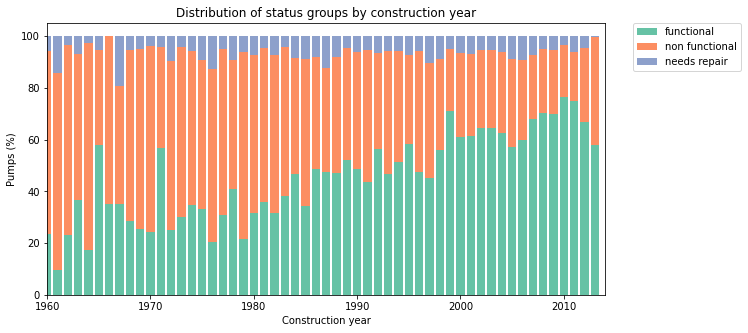

In [181]:
#newer pumps tend to be more functional
fig, ax = plt.subplots(figsize=(10,5))
labels = raw['construction_year'].sort_values().unique()
ax.bar(labels, construction['perc_functional'], label = 'functional',  color = '#66c2a5')
ax.bar (labels, construction['perc_non_functional'], label = 'non functional', bottom = construction['perc_functional'] , color = '#fc8e62')
ax.bar(labels, construction['perc_functional_needs_repair'], label = 'needs repair', bottom = construction['perc_functional'] + construction['perc_non_functional'],  color = '#8da0cb')
ax.set(title = 'Distribution of status groups by construction year', xlabel = 'Construction year', ylabel = 'Pumps (%)')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.xlim([1960,2014])
plt.show()

It is quite clear that newer pumps have a higher chance of being functional than pumps that were build longer ago. I will create a feature that represents tha age of the pump at recording. Sinds the first quartile of the data is zero, the construction year of many pumps is unknown. We can impute by the mean or median construction year of the pumps, but we could also see if there are smarter ways of imputing this feature.

In [157]:
raw.shape

(74250, 41)

In [156]:
raw.head()

,id,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,functional,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,functional,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,functional,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,non functional,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,functional,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe


In [121]:
raw.groupby([  'region', 'region_code', 'district_code'])['id'].count().reset_index()

,region,region_code,district_code,id
0,Arusha,2,1,226
1,Arusha,2,2,1460
2,Arusha,2,3,143
3,Arusha,2,5,245
4,Arusha,2,6,391
5,Arusha,2,7,1244
6,Arusha,24,30,402
7,Dar es Salaam,7,1,121
8,Dar es Salaam,7,2,633
9,Dar es Salaam,7,3,266


In [124]:
raw.groupby([  'region', 'lga', 'ward', 'subvillage'])['id'].count().reset_index()

,region,lga,ward,subvillage,id
0,Arusha,Arusha Rural,Bangata,Engikaleti,23
1,Arusha,Arusha Rural,Bangata,Gwasei,2
2,Arusha,Arusha Rural,Bangata,Kwaniche,5
3,Arusha,Arusha Rural,Bangata,Lobolosi,1
4,Arusha,Arusha Rural,Bangata,Melenyi,1
...,...,...,...,...,...
30855,Tanga,Tanga,Tongoni,Mundura,4
30856,Tanga,Tanga,Tongoni,Mwarongo,9
30857,Tanga,Tanga,Tongoni,Tambarani,1
30858,Tanga,Tanga,Tongoni,Tambarare,1


In [125]:
raw.groupby([  'region', 'ward', 'subvillage'])['id'].count().reset_index()

,region,ward,subvillage,id
0,Arusha,Akheri,Ifuriny,3
1,Arusha,Akheri,Makisoro,4
2,Arusha,Akheri,Manyile,3
3,Arusha,Akheri,Maring'A,6
4,Arusha,Akheri,Mavinuni,4
...,...,...,...,...
30853,Tanga,Vugiri,Misufini,1
30854,Tanga,Vugiri,Msikitini,1
30855,Tanga,Vugiri,Sinai,1
30856,Tanga,Zirai,Kambai,7


In [31]:
https://adb-7670641235086533.13.azuredatabricks.net/?o=7670641235086533#notebook/3502774562948572/command/3502774562948605
https://adb-7670641235086533.13.azuredatabricks.net/?o=7670641235086533#notebook/1263564952756304/command/2552995492087043
https://adb-7670641235086533.13.azuredatabricks.net/?o=7670641235086533#notebook/3965069572358914/command/3965069572358959

SyntaxError: ignored

In [ ]:
braw.head()

In [122]:
raw.head()

,id,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,functional,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,functional,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,functional,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,non functional,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,functional,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
